<a href="https://colab.research.google.com/github/YuvrajHarsh04/AI-Voice-Assistant-integrated-ChatGPT-API-and-OpenAI-Whisper/blob/main/computervision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#1) Unit-1: Image Enhancement & Edge/Corner Detection

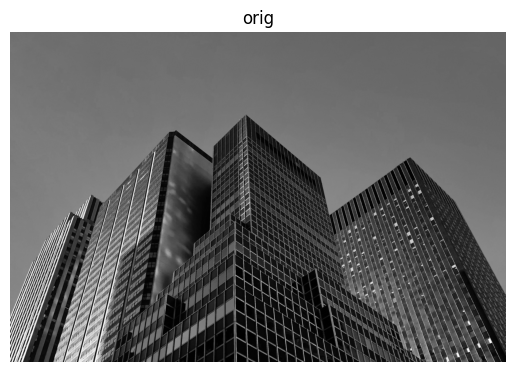

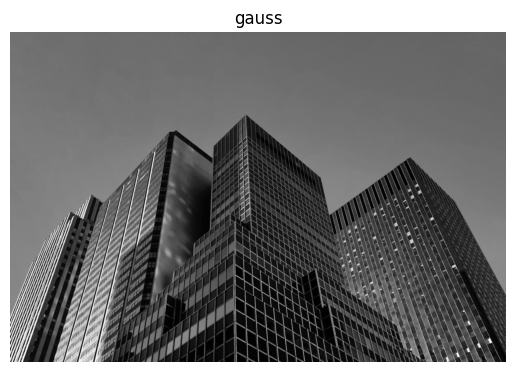

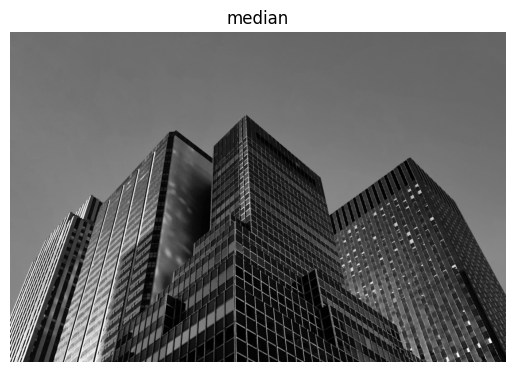

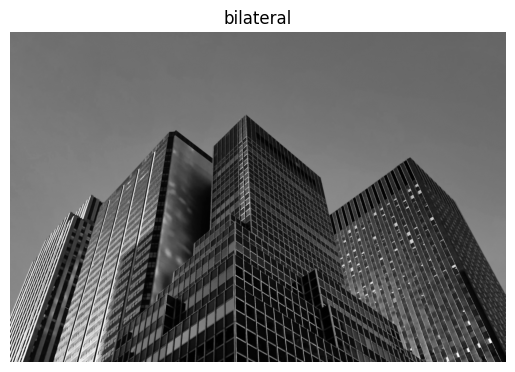

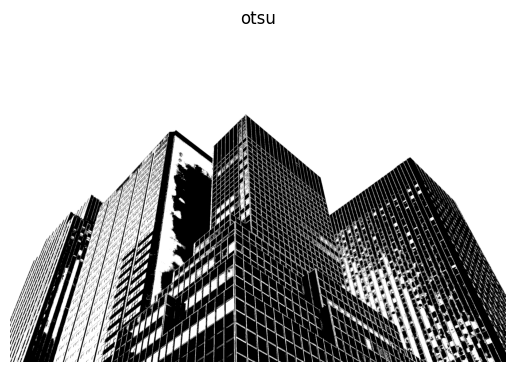

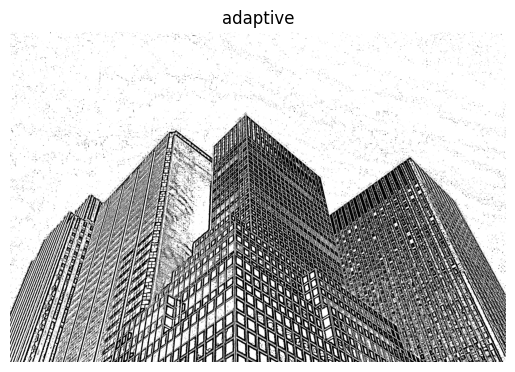

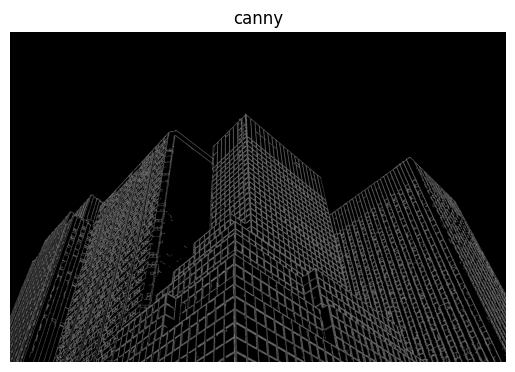

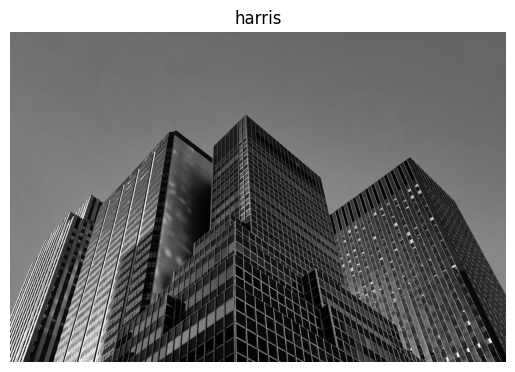

In [ ]:
import cv2 as cv, numpy as np, matplotlib.pyplot as plt

img = cv.imread('/content/photo-1560179707-f14e90ef3623.jpeg', cv.IMREAD_GRAYSCALE)

blur_g = cv.GaussianBlur(img, (5,5), 1.0)
blur_m = cv.medianBlur(img, 5)
blur_b = cv.bilateralFilter(img, 9, 75, 75)

_, th_otsu = cv.threshold(img, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)
th_adapt = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,
                                cv.THRESH_BINARY, 25, 2)

edges_sobel = cv.Sobel(img, cv.CV_64F, 1, 0, ksize=3)
edges_canny = cv.Canny(img, 100, 200)

harris = cv.cornerHarris(np.float32(img)/255., 2, 3, 0.04)
harris_norm = cv.normalize(harris, None, 0, 255, cv.NORM_MINMAX).astype(np.uint8)
corners = cv.cvtColor(img, cv.COLOR_GRAY2BGR)
corners[harris_norm>180] = [0,0,255]

figs = [img, blur_g, blur_m, blur_b, th_otsu, th_adapt, edges_canny, corners]
titles = ["orig","gauss","median","bilateral","otsu","adaptive","canny","harris"]
for i,(f,t) in enumerate(zip(figs,titles),1):
    plt.figure(i); plt.title(t); plt.imshow(f, cmap='gray'); plt.axis('off')
plt.show()


In [ ]:
#2) Unit-2: Shape & Region Analysis with Descriptors

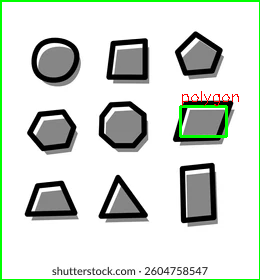

In [ ]:
import cv2 as cv, numpy as np
from google.colab.patches import cv2_imshow

img = cv.imread('/content/collection-twodimensional-shapes-icons-solid-260nw-2604758547.jpg.webp', cv.IMREAD_GRAYSCALE)
_, bw = cv.threshold(img, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)
bw = cv.morphologyEx(bw, cv.MORPH_OPEN, np.ones((3,3),np.uint8), iterations=1)

num, labels, stats, centroids = cv.connectedComponentsWithStats(bw, connectivity=8)
out = cv.cvtColor(img, cv.COLOR_GRAY2BGR)

for i in range(1, num):
    if stats[i, cv.CC_STAT_AREA] < 200: continue
    mask = (labels==i).astype(np.uint8)*255
    cnts, _ = cv.findContours(mask, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
    if not cnts: continue
    cnt = cnts[0]
    area = cv.contourArea(cnt); peri = cv.arcLength(cnt, True)
    circularity = 4*np.pi*area/(peri*peri + 1e-6)
    hu = cv.HuMoments(cv.moments(cnt)).flatten()

    shape = "circle" if circularity>0.8 else "polygon"
    x,y,w,h = cv.boundingRect(cnt)
    cv.rectangle(out,(x,y),(x+w,y+h),(0,255,0),2)
    cv.putText(out, f"{shape}", (x,y-5), cv.FONT_HERSHEY_SIMPLEX, 0.5,(0,0,255),1)

cv2_imshow(out)

In [ ]:
#3) Unit-3: Hough (Lines, Circles, Ellipses) + Iris Case

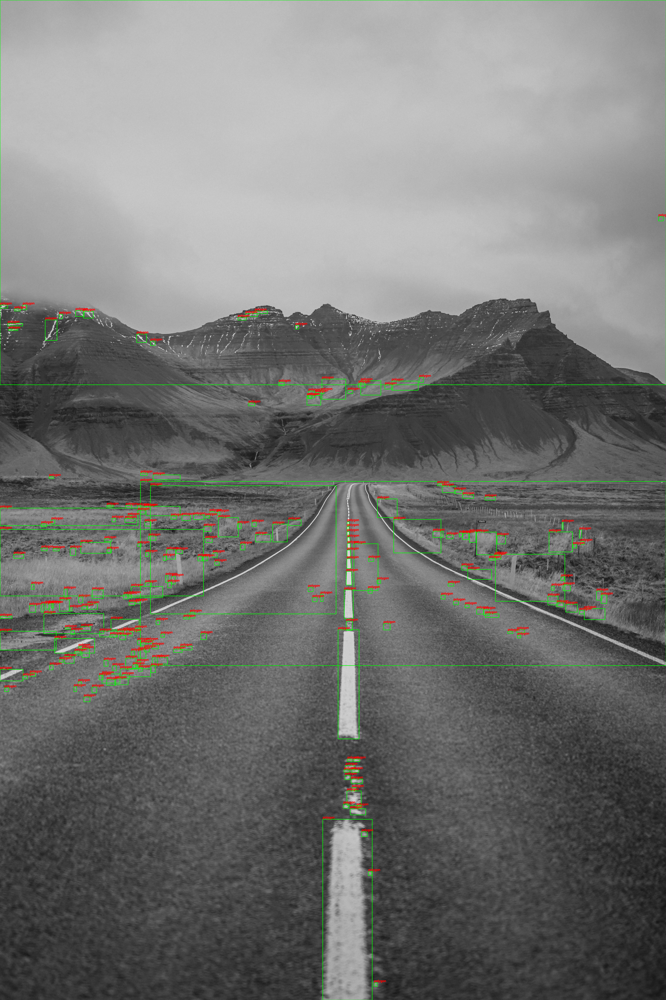

In [ ]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

# Load grayscale image
img = cv.imread('/content/pexels-sebastian-palomino-933481-1955134.jpg', cv.IMREAD_GRAYSCALE)
if img is None:
    raise FileNotFoundError("Could not read '/content/premium_photo-1664547606209-fb31ec979c85.jpeg'. Check the path.")

# Binarize + small cleanup
_, bw = cv.threshold(img, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)
bw = cv.morphologyEx(bw, cv.MORPH_OPEN, np.ones((3, 3), np.uint8), iterations=1)

# Connected components
num, labels, stats, centroids = cv.connectedComponentsWithStats(bw, connectivity=8)

# Prepare color output for drawing
out = cv.cvtColor(img, cv.COLOR_GRAY2BGR)

# Skip label 0 (background)
for i in range(1, num):
    # Filter tiny blobs
    if stats[i, cv.CC_STAT_AREA] < 200:
        continue

    # Mask for this component
    mask = (labels == i).astype(np.uint8) * 255

    # Find contour
    cnts, _ = cv.findContours(mask, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
    if not cnts:
        continue
    cnt = cnts[0]

    # Basic shape features
    area = cv.contourArea(cnt)
    peri = cv.arcLength(cnt, True)
    if peri == 0:
        continue
    circularity = 4 * np.pi * area / (peri * peri + 1e-6)

    # Hu moments (not used in label here, but computed if you need)
    hu = cv.HuMoments(cv.moments(cnt)).flatten()

    # Simple rule: circle vs polygon
    shape = "circle" if circularity > 0.80 else "polygon"

    # Draw box + label
    x, y, w, h = cv.boundingRect(cnt)
    cv.rectangle(out, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv.putText(out, shape, (x, y - 5), cv.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 255), 2)

# Show result in Colab
cv2_imshow(out)

In [ ]:
#4) Unit-4: Vision & Motion — Optical Flow Tracking

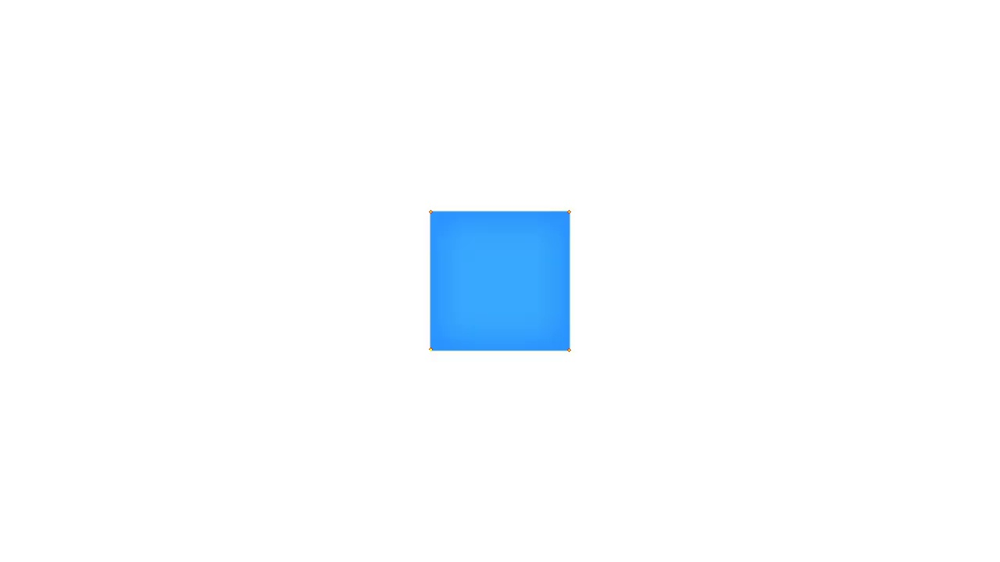

In [ ]:
#@title ▶️ Run Optical Flow (Use your given path)
VIDEO_PATH = r"/content/Moving Shapes - Milepost Creative (720p, h264, youtube).mp4"
MODE = 'sparse'  #@param ['sparse', 'dense']
SCALE = 1.0      #@param {type:'number'}

import os, cv2 as cv, numpy as np
from IPython.display import display, clear_output

assert os.path.exists(VIDEO_PATH), f"File not found: {VIDEO_PATH}"

cap = cv.VideoCapture(VIDEO_PATH)
ok, prev = cap.read(); assert ok, 'Cannot read first frame'
if SCALE != 1.0:
  prev = cv.resize(prev, None, fx=SCALE, fy=SCALE)
h, w = prev.shape[:2]
prev_gray = cv.cvtColor(prev, cv.COLOR_BGR2GRAY)

if MODE == 'sparse':
  # Shi–Tomasi + Pyramidal LK (minimal)
  p0 = cv.goodFeaturesToTrack(prev_gray, maxCorners=200, qualityLevel=0.01, minDistance=7)
  mask = np.zeros_like(prev)
  while True:
    ok, frame = cap.read()
    if not ok: break
    if SCALE != 1.0:
      frame = cv.resize(frame, (w, h))
    gray = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
    if p0 is None or len(p0) == 0:
      p0 = cv.goodFeaturesToTrack(prev_gray, 200, 0.01, 7)
      mask[:] = 0
    p1, st, err = cv.calcOpticalFlowPyrLK(prev_gray, gray, p0, None)
    if p1 is None: break
    good_new, good_old = p1[st==1], p0[st==1]
    for (n, o) in zip(good_new, good_old):
      a, b = n.ravel().astype(int); c, d = o.ravel().astype(int)
      cv.line(mask, (a, b), (c, d), (0, 255, 0), 2)
      cv.circle(frame, (a, b), 2, (0, 0, 255), -1)
    vis = cv.add(frame, mask)
    _, disp = cv.imencode('.jpg', vis)
    clear_output(wait=True)
    display({'image/jpeg': disp.tobytes()}, raw=True)
    prev_gray, p0 = gray, good_new.reshape(-1, 1, 2)

else:
  # Dense Farnebäck
  hsv = np.zeros_like(prev); hsv[..., 1] = 255
  while True:
    ok, frame = cap.read()
    if not ok: break
    if SCALE != 1.0:
      frame = cv.resize(frame, (w, h))
    gray = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
    flow = cv.calcOpticalFlowFarneback(prev_gray, gray, None,
                                       0.5, 3, 15, 3, 5, 1.2, 0)
    mag, ang = cv.cartToPolar(flow[..., 0], flow[..., 1])
    hsv[..., 0] = (ang * 180/np.pi/2).astype(np.uint8)
    hsv[..., 2] = np.clip(mag * 10, 0, 255).astype(np.uint8)
    vis = cv.cvtColor(hsv, cv.COLOR_HSV2BGR)
    _, disp = cv.imencode('.jpg', vis)
    clear_output(wait=True)
    display({'image/jpeg': disp.tobytes()}, raw=True)
    prev_gray = gray

cap.release()


In [ ]:
#5) Unit-5: Eigenfaces Face Recognition (Application)

In [ ]:
from sklearn.datasets import fetch_lfw_people
lfw = fetch_lfw_people(min_faces_per_person=10, resize=0.5, color=False)

import numpy as np
X = lfw.data
y = lfw.target
names = list(lfw.target_names)
H, W = lfw.images.shape[1:]

# 3) Train your PCA+SVC pipeline (your code, slight tweak to skip scaling mean issue)
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

Xtr, Xte, ytr, yte = train_test_split(X, y, test_size=0.2, stratify=y, random_state=0)
model = Pipeline([
    ("scaler", StandardScaler(with_mean=True, with_std=True)),
    ("pca", PCA(n_components=0.95, svd_solver='full')),  # ← Eigenfaces are computed here
    ("clf", SVC(kernel='rbf', probability=True))
]).fit(Xtr, ytr)

ypr = model.predict(Xte)
print(classification_report(yte, ypr, target_names=names))


                           precision    recall  f1-score   support

             Abdullah Gul       1.00      0.25      0.40         4
             Adrien Brody       0.00      0.00      0.00         2
         Alejandro Toledo       0.50      0.25      0.33         8
             Alvaro Uribe       0.50      0.29      0.36         7
          Amelie Mauresmo       0.00      0.00      0.00         4
             Andre Agassi       0.60      0.43      0.50         7
             Andy Roddick       0.00      0.00      0.00         3
           Angelina Jolie       0.00      0.00      0.00         4
              Ann Veneman       0.00      0.00      0.00         2
          Anna Kournikova       0.00      0.00      0.00         2
            Ari Fleischer       0.00      0.00      0.00         3
             Ariel Sharon       0.57      0.50      0.53        16
    Arnold Schwarzenegger       0.00      0.00      0.00         8
     Atal Bihari Vajpayee       1.00      0.20      0.33     

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
